In [1]:
import math
import os, sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict
import datetime as dt
import random

cwd = os.getcwd()
project_path = cwd[:cwd.find('pygents')+7]
if project_path not in sys.path: sys.path.append(project_path)
os.chdir(project_path)

if 'aigents_api' in sys.modules:
    del sys.modules['aigents_api']
if 'learn' in sys.modules:
    del sys.modules['learn']
if 'util' in sys.modules:
    del sys.modules['util']

from pygents.learn import count_ngrams_plus, count_ngrams_plus_tf_idf
from pygents.aigents_api import TextMetrics
from pygents.plot import plot_dict
from pygents.util import dictcount

model_family = 'multiclass_view_cleaned'
if not os.path.exists('data/models/distortions/multiclass_task/split_babacan_multiclass/'+model_family+'/'):
    os.makedirs('data/models/distortions/multiclass_task/split_babacan_multiclass/'+model_family+'/')
for split_name in ['first_split','second_split','third_split']:
    split_path = 'data/models/distortions/multiclass_task/split_babacan_multiclass/'+model_family+'/'+split_name+'/'
    if not os.path.exists(split_path):
        os.makedirs(split_path)

grand_t0 = dt.datetime.now()

def language_metrics(metrics_list, name_split_folder):
    metrics = {}
    for m in metrics_list:
        metrics[m] = f'data/models/distortions/multiclass_task/split_babacan_multiclass/{model_family}/{name_split_folder}/{m}.txt'
    return metrics

In [ ]:
from datasets import load_dataset

# dataset: https://huggingface.co/datasets/halilbabacan/combined_synthetic_cognitive_distortions/tree/main
ds = load_dataset(
    "halilbabacan/combined_synthetic_cognitive_distortions",
    split="train",
)

df = ds.to_pandas()
df = df.rename(columns={'text': 'Patient Question', 'label': 'Dominant Distortion'})
df.insert(1, 'Distorted part', value = np.nan)
df.insert(3, 'Secondary Distortion (Optional)', value = np.nan)
# Remove the row with index 738 because it contains a NaN in the text column
df = df.drop(index=738)


mapping = {
    "Labelling":            "Labeling",
    "Mental Filter":        "Mental filter",
    "Should Statements":    "Should statements",
    "All-or-Nothing Thinking": "All-or-nothing thinking"
}

df['Dominant Distortion'] = df['Dominant Distortion'].map(mapping).fillna(df['Dominant Distortion'])

df

,Patient Question,Distorted part,Dominant Distortion,Secondary Distortion (Optional)
0,John walked past me without saying a word He m...,NaN,Mind Reading,NaN
1,"During the meeting, Sarah didn't look at me on...",NaN,Mind Reading,NaN
2,Mike didn't respond to my text right away He m...,NaN,Mind Reading,NaN
3,Jessica didn't smile when she saw me She must ...,NaN,Mind Reading,NaN
4,Tom didn't invite me to his party He must not ...,NaN,Mind Reading,NaN
...,...,...,...,...
4526,I’m a 21 year old female. I spent most of my l...,NaN,No Distortion,NaN
4527,Now I am at university my peers around me all ...,NaN,Overgeneralization,NaN
4528,He claims he’s severely depressed and has outb...,NaN,Mental filter,NaN
4529,From the U.S.: I am a 21 year old woman who ha...,NaN,No Distortion,NaN


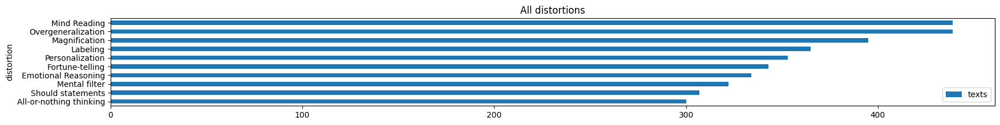

In [3]:
dists = {}
for _, row in df.iterrows():
        # Text definition: first, check the 2nd column; if NaN, take the text from the 1st column.
        text = row.iloc[1] if pd.notna(row.iloc[1]) else row.iloc[0]
        primary_distortion = row.iloc[2]  # The main cognitive distortion from the 3rd column
        secondary_distortion = row.iloc[3] if pd.notna(row.iloc[3]) else 'No Distortion'  # The secondary distortion from the 4th column, if it exists
        ground_distortions = []
        if primary_distortion != 'No Distortion':
            ground_distortions.append(primary_distortion)
        if secondary_distortion != 'No Distortion':
            ground_distortions.append(secondary_distortion)
        for d in ground_distortions:
            dictcount(dists,d)
        
plot_dict(
    dists,
    labels="distortion",
    values="texts",
    title="All distortions",
    head=20
)

# Create learning functions
### Functions for including key N-grams and creating model files

In [4]:
def ngrams_inclusion(model_ngram, ngram_inclusion_threshold):
    filtered_model_ngram = {}
    for distortion, ngram_dict in model_ngram.items():
        # Find the maximum metric value for the current distortion
        max_value = max(ngram_dict.values()) if ngram_dict else 0
        threshold_value = max_value * (ngram_inclusion_threshold / 100)

        # Filter n-grams that meet or exceed the threshold value
        filtered_model_ngram[distortion] = {
            ngram: metric for ngram, metric in ngram_dict.items() if metric >= threshold_value
        }
    return filtered_model_ngram

def create_model_files(filtered_model_ngram, name_split_folder):
    # Create .txt files for each distortion
    output_dir = f'data/models/distortions/multiclass_task/split_babacan_multiclass/{model_family}/{name_split_folder}'
    distortion_file_path = f"{output_dir}/Distortion.txt"
    distortions_labels = []

    with open(distortion_file_path, "w", encoding="utf-8") as distortion_file:
        for distortion, ngrams in filtered_model_ngram.items():
            distortion_ = distortion.replace(" ", "_")
            file_path = f"{output_dir}/{distortion_}.txt"
            sorted_ngrams = sorted(ngrams.items(), key=lambda x: x[1], reverse=True) 
            distortions_labels.append(distortion_)
            with open(file_path, "w", encoding="utf-8") as f:
                for ngram, metric_value in sorted_ngrams:
                    ngram_str = ' '.join(ngram) 
                    f.write(f"{ngram_str}\t{metric_value}\n")
                    if distortion != "No Distortion":
                            distortion_file.write(f"{ngram_str}\t{metric_value}\n")
    
    return (list(set(distortions_labels) - {'No_Distortion'}))

### Evaluate functions

In [5]:
all_metrics = ['All-or-nothing_thinking','Fortune-telling','Mental_filter','Overgeneralization','Labeling',
          'Mind_Reading','Personalization','Emotional_Reasoning','Magnification','Should_statements']

def our_evaluator_test(expected_distortions,text,threshold):
    dic = {}
    for m in all_metrics:
        dic[m] = True if (m in expected_distortions) else False
    return dic

def our_evaluator_tm(tm,text,threshold):
    metrics = tm.get_sentiment_words(text)
    dic = {}
    for m in all_metrics:
        dic[m] = True if m in metrics and metrics[m] > threshold else False
    return dic

def our_evaluator_true(tm,text,threshold):
    dic = {}
    for m in all_metrics:
        dic[m] = True
    return dic
    
def our_evaluator_false(tm,text,threshold):
    dic = {}
    for m in all_metrics:
        dic[m] = False
    return dic

def our_evaluator_random(tm,text,threshold):
    dic = {}
    for m in all_metrics:
        dic[m] = random.choice([True, False])
    return dic

def dictval(dic,key,val):
    return dic[key] if key in dic else val 

def pre_rec_f1_from_counts(true_positive, true_negative, false_positive, false_negative):
    precision = true_positive / (true_positive + false_positive) if (true_positive + false_positive) > 0 else 0
    recall = true_positive / (true_positive + false_negative) if (true_positive + false_negative) > 0 else 0
    return precision, recall, 2 * precision * recall / (precision + recall) if precision > 0 or recall > 0 else 0 

def evaluate_tm_df(df,tm,evaluator,threshold,debug=False):
    true_positives = {}
    true_negatives = {}
    false_positives = {}
    false_negatives = {}
    pre = {}
    rec = {}
    f1 = {}
    acc = {}
    for _, row in df.iterrows():
        # Text definition: first, check the 2nd column; if NaN, take the text from the 1st column.
        text = row.iloc[1] if pd.notna(row.iloc[1]) else row.iloc[0]
        primary_distortion = row.iloc[2]  # The main cognitive distortion from the 3rd column
        secondary_distortion = row.iloc[3] if pd.notna(row.iloc[3]) else 'No Distortion'  # The secondary distortion from the 4th column, if it exists
        ground_distortions = []
        if primary_distortion != 'No Distortion':
            ground_distortions.append(primary_distortion.replace(' ','_'))
        if secondary_distortion != 'No Distortion':
            ground_distortions.append(secondary_distortion.replace(' ','_'))

        if evaluator == our_evaluator_test:
            distortions_by_metric = evaluator(ground_distortions,text,threshold) #hack to test metrics
        else:
            distortions_by_metric = evaluator(tm,text,threshold)

        if debug:
            print(ground_distortions,'=>',[m for m in distortions_by_metric if distortions_by_metric[m]])
        
        for metric in distortions_by_metric:
            our_distortion = distortions_by_metric[metric]
            if (metric in ground_distortions) and our_distortion == True:
                dictcount(true_positives,metric)
            if (not metric in ground_distortions) and our_distortion == True:
                dictcount(false_positives,metric)
            if (not metric in ground_distortions) and our_distortion == False:
                dictcount(true_negatives,metric)
            if (metric in ground_distortions) and our_distortion == False:
                dictcount(false_negatives,metric)

    if debug:
        #print()
        print('TP:',true_positives)
        print('FP:',false_positives)
        print('TN:',true_negatives)
        print('FN:',false_negatives)
    
    for metric in all_metrics:
        precision, recall, f1score = pre_rec_f1_from_counts(dictval(true_positives,metric,0), dictval(true_negatives,metric,0), 
                                   dictval(false_positives,metric,0), dictval(false_negatives,metric,0))
        pre[metric] = precision
        rec[metric] = recall
        f1[metric] = f1score
        acc[metric] = (dictval(true_positives,metric,0) + dictval(true_negatives,metric,0)) / len(df)
    
    return pre, rec, f1, acc


### Function for analyzing the dataset

In [16]:
def analyse_dataset(ngram_selection_metric, ngram_max, ngram_inclusion_threshold, df_train, df_test, name_split_folder, print_or_plot):
    
    if name_split_folder == 'first_split' and print_or_plot == 'print_results':
        print('\nN-gram selection metric:', ngram_selection_metric)
        print('N-gram max length:', ngram_max)
        print('N-gram inclusion threshold:', ngram_inclusion_threshold)

    if ngram_selection_metric == 'TF-IDF':
        model_ngram = count_ngrams_plus_tf_idf(df_train,ngram_max,binary=False,clean_punct=True)
    
    elif ngram_selection_metric in ['F','UF','FN','UFN','UFN/D/D','FN*UFN','FN*UFN/D','FN*UFN*UF/D/D','CFR','FCR','MR','NLMI']:
        distortions, frequency, all_n_grams, frequency_self_normalized, unique_frequency, uniq_all_n_grams, n_gram_distortions, \
        norm_uniq_n_gram_dicts, n_gram_distortions_counts, norm, unique_frequency_self_normalized, norm_norm_uniq, norm_norm_uniq_norm, \
        norm_norm_uniq_norm_norm, fcr, cfr, mr, nl_mi, N = count_ngrams_plus(df_train,ngram_max,binary=False)
        
        selection_metrics = {
            'F':frequency,
            'UF':unique_frequency,
            'FN':frequency_self_normalized,
            'UFN':unique_frequency_self_normalized,
            'UFN/D/D':norm_uniq_n_gram_dicts,
            'FN*UFN':norm_norm_uniq,
            'FN*UFN/D':norm_norm_uniq_norm,
            'CFR':cfr,
            'FCR':fcr,
            'MR':mr,
            'NLMI':nl_mi}
        
        model_ngram = selection_metrics[ngram_selection_metric]

    # Filter out values below the threshold
    filtered_model_ngram = ngrams_inclusion(model_ngram, ngram_inclusion_threshold)

    # Create .txt files for each distortion
    distortions_labels = create_model_files(filtered_model_ngram, name_split_folder)
    tm = TextMetrics(language_metrics(distortions_labels, name_split_folder), encoding = "utf-8", debug=False)

    if print_or_plot == 'print_results':
        if name_split_folder == 'first_split':
            print('\tFIRST COMBINATION')
        elif name_split_folder == 'second_split':
            print('\n\tSECOND COMBINATION')
        elif name_split_folder == 'third_split':
            print('\n\tTHIRD COMBINATION')

    pres = [[] for i in range(len(all_metrics))]
    recs = [[] for i in range(len(all_metrics))]
    f1s = [[] for i in range(len(all_metrics))]
    accs = [[] for i in range(len(all_metrics))]
            
    for threshold in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]:
        pre, rec, f1, acc = evaluate_tm_df(df_test,tm,our_evaluator_tm,threshold)
        mi = 0
        if print_or_plot == 'print_results':
            #print('\t\tThreshold:', threshold, '(distortion, precision, recall, F1 score, accuracy):')
            print('\t\tThreshold:', threshold, '(distortion, F1 score):')
        for metric in all_metrics:
            pres[mi].append(pre[metric])
            recs[mi].append(rec[metric])
            f1s[mi].append(f1[metric])
            accs[mi].append(acc[metric])
            mi += 1
            if print_or_plot == 'print_results':
                #print('\t\t\t', metric, pre[metric], rec[metric], f1[metric], acc[metric], sep='\t')
                print('\t\t\t', metric, f1[metric], sep='\t')

    return {metric: f1s[i] for i, metric in enumerate(all_metrics)}

# Grid search
### Perform a grid search over all hyper-parameters to determine the best combination for building the model

In [7]:
def grid_search(df):
    part1 = df[df.index % 3 == 1]
    part2 = df[df.index % 3 == 2]
    part3 = df[df.index % 3 == 0]

    splits = [
        (pd.concat([part1, part2]), part3),  # (1 + 2) -> train, (3) -> test
        (pd.concat([part1, part3]), part2),  # (1 + 3) -> train, (2) -> test
        (pd.concat([part2, part3]), part1)   # (2 + 3) -> train, (1) -> test
    ]

    for ngram_selection_metric in ['TF-IDF','F','UF','FN','UFN','UFN/D/D','FN*UFN','FN*UFN/D','CFR','FCR','MR','NLMI']:
        for ngram_max in range (1, 5):
            for ngram_inclusion_threshold in [90, 80, 70, 60, 50, 40, 30, 20, 10, 0]:
                for i, (train_df, test_df) in enumerate(splits, start=1):
                    if i == 1:
                        first_split_f1s = analyse_dataset(ngram_selection_metric, ngram_max, ngram_inclusion_threshold, train_df, test_df, 'first_split', 'print_results')
                    elif i == 2:
                        second_split_f1s = analyse_dataset(ngram_selection_metric, ngram_max, ngram_inclusion_threshold, train_df, test_df, 'second_split', 'print_results')
                    elif i == 3:
                        third_split_f1s = analyse_dataset(ngram_selection_metric, ngram_max, ngram_inclusion_threshold, train_df, test_df, 'third_split', 'print_results')

In [8]:
grid_search(df)


N-gram selection metric: TF-IDF
N-gram max length: 1
N-gram inclusion threshold: 90
	FIRST COMBINATION
		Threshold: 0.1 (distortion, precision, recall, F1 score, accuracy):
				All-or-nothing_thinking	0.2815126050420168	0.6568627450980392	0.3941176470588235	0.8635761589403973
				Fortune-telling	0.3652173913043478	0.375	0.3700440528634361	0.9052980132450331
				Mental_filter	0.17866666666666667	0.6767676767676768	0.28270042194092826	0.7748344370860927
				Overgeneralization	0.1308139534883721	0.3082191780821918	0.1836734693877551	0.7350993377483444
				Labeling	0.19186046511627908	0.5546218487394958	0.28509719222462204	0.7807947019867549
				Mind_Reading	0.3402061855670103	0.4342105263157895	0.38150289017341044	0.8582781456953642
				Personalization	0.28350515463917525	0.44	0.3448275862068965	0.8615894039735099
				Emotional_Reasoning	0.21445221445221446	0.8	0.338235294117647	0.7615894039735099
				Magnification	0.1272965879265092	0.776	0.21871476888387822	0.5410596026490067
				Shoul

In [12]:
grid_search(df)


N-gram selection metric: TF-IDF
N-gram max length: 1
N-gram inclusion threshold: 90
	FIRST COMBINATION
		Threshold: 0.1 (distortion, F1 score):
				All-or-nothing_thinking	0.3941176470588235
				Fortune-telling	0.3700440528634361
				Mental_filter	0.28270042194092826
				Overgeneralization	0.1836734693877551
				Labeling	0.28509719222462204
				Mind_Reading	0.38150289017341044
				Personalization	0.3448275862068965
				Emotional_Reasoning	0.338235294117647
				Magnification	0.21871476888387822
				Should_statements	0.7164179104477612
		Threshold: 0.2 (distortion, F1 score):
				All-or-nothing_thinking	0.4710144927536231
				Fortune-telling	0.41791044776119396
				Mental_filter	0.28755364806866957
				Overgeneralization	0.1836734693877551
				Labeling	0.28509719222462204
				Mind_Reading	0.38150289017341044
				Personalization	0.3448275862068965
				Emotional_Reasoning	0.3762781186094069
				Magnification	0.22754491017964068
				Should_statements	0.7912087912087913
		Threshold: 0.3 (di

### Our best model obtained through the optimal combination of hyper-parameters

In [13]:
# Best model
part1 = df[df.index % 3 == 1]
part2 = df[df.index % 3 == 2]
part3 = df[df.index % 3 == 0]

splits = [
    (pd.concat([part1, part2]), part3),  # (1 + 2) -> train, (3) -> test
    (pd.concat([part1, part3]), part2),  # (1 + 3) -> train, (2) -> test
    (pd.concat([part2, part3]), part1)   # (2 + 3) -> train, (1) -> test
]

for i, (train_df, test_df) in enumerate(splits, start=1):
    if i == 1:
        first_split_f1s = analyse_dataset('FN', 4, 90, train_df, test_df, 'first_split', 'print_results')
    elif i == 2:
        second_split_f1s = analyse_dataset('FN', 4, 90, train_df, test_df, 'second_split', 'print_results')
    elif i == 3:
        third_split_f1s = analyse_dataset('FN', 4, 90, train_df, test_df, 'third_split', 'print_results')


N-gram selection metric: FN
N-gram max length: 4
N-gram inclusion threshold: 90
	FIRST COMBINATION
		Threshold: 0.1 (distortion, F1 score):
				All-or-nothing_thinking	0.3876404494382023
				Fortune-telling	0.4056603773584906
				Mental_filter	0.35799522673031026
				Overgeneralization	0.2331288343558282
				Labeling	0.21075268817204304
				Mind_Reading	0.36794171220400734
				Personalization	0.3906976744186047
				Emotional_Reasoning	0.40806045340050384
				Magnification	0.2647058823529412
				Should_statements	0.4376731301939058
		Threshold: 0.2 (distortion, F1 score):
				All-or-nothing_thinking	0.4184615384615385
				Fortune-telling	0.4332493702770781
				Mental_filter	0.39370078740157477
				Overgeneralization	0.25165562913907286
				Labeling	0.22327790973871733
				Mind_Reading	0.39453125
				Personalization	0.4221105527638191
				Emotional_Reasoning	0.4525139664804469
				Magnification	0.2857142857142857
				Should_statements	0.4817073170731707
		Threshold: 0.3 (distortion, F1 

# Plot heatmaps 
## Plot heatmaps illustrating the search for optimal hyperparameters

In [14]:
thresholds = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

def matrix_plot(row_labels, col_labels, matrix, absmax, title = None, vmin = None, vmax = None, dpi = None, titlefontsize = None, width = 20):
    plt.rcParams["figure.figsize"] = (width,len(row_labels)/4)
    if not dpi is None:
        plt.rcParams["figure.dpi"] = dpi
    p = sns.heatmap(matrix, xticklabels=col_labels, yticklabels=row_labels, 
                    vmin = -absmax if vmin is None else vmin, 
                    vmax = absmax if vmax is None else vmax, 
                    cmap='RdYlGn', annot=True)
    if title is not None:
        if titlefontsize is None:
            titlefontsize = 32 if len(title) < 50 else round(32 * 50 / len(title))
        p.set_title(title,fontsize = titlefontsize)
    plt.show()

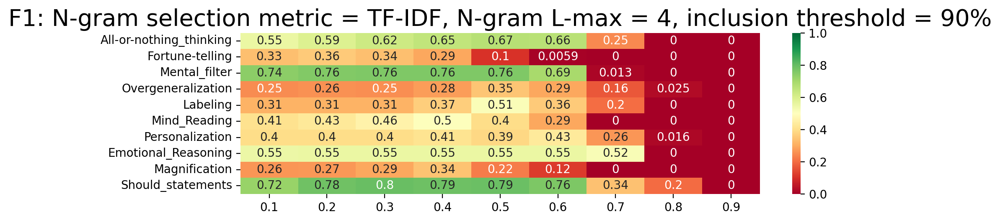

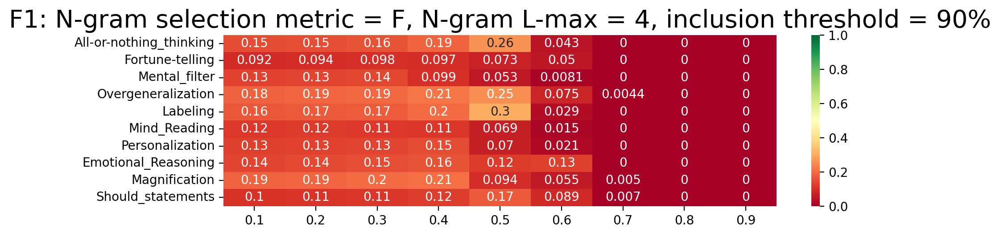

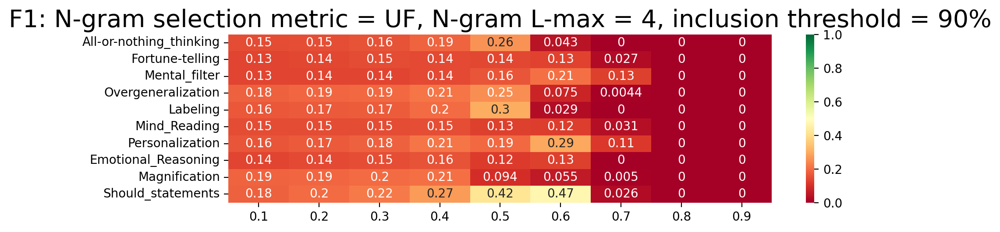

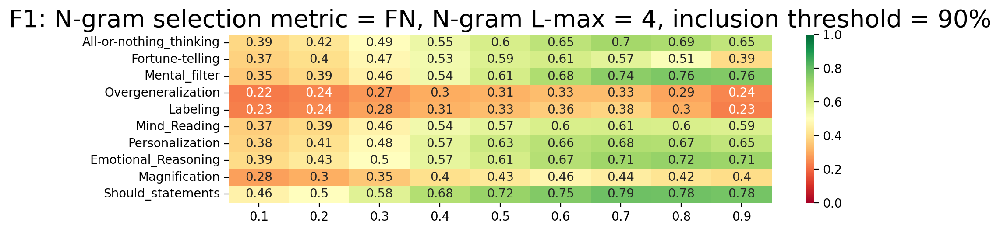

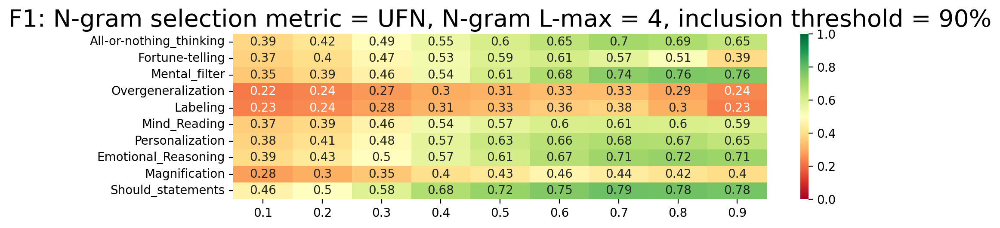

...

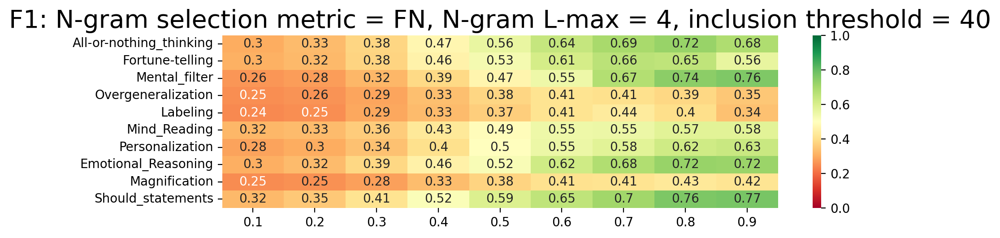

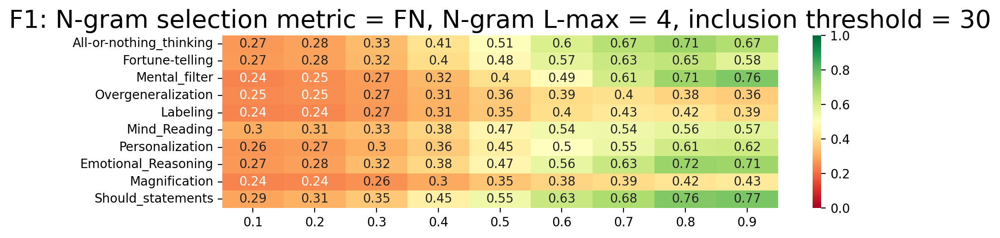

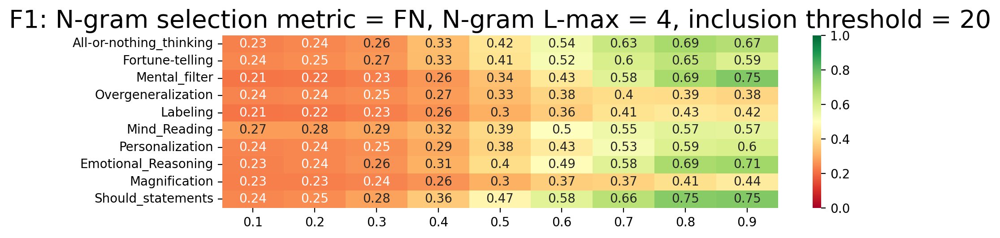

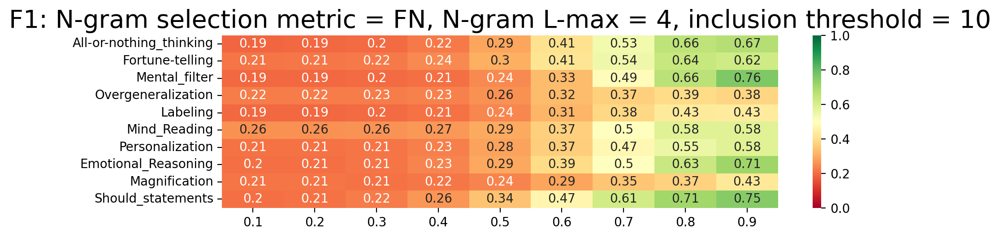

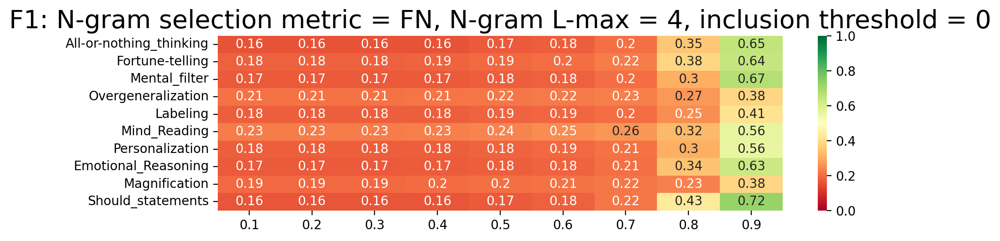

In [17]:
ngram_selection_metrics = ['TF-IDF','F','UF','FN','UFN','UFN/D/D','FN*UFN','FN*UFN/D','CFR','FCR','MR','NLMI']
thresholds = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
ngram_max_values = [1, 2, 3, 4]
ngram_inclusion_thresholds = [90, 80, 70, 60, 50, 40, 30, 20, 10, 0]

# 1) N-gram selection metric - threshold

for i, ngram_selection_metric in enumerate(ngram_selection_metrics):

    for k, (train_df, test_df) in enumerate(splits, start=1):
        if k == 1:
            first_split_f1s = analyse_dataset(ngram_selection_metric, 4, 90, train_df, test_df, 'first_split', 'plot_results')
        elif k == 2:
            second_split_f1s = analyse_dataset(ngram_selection_metric, 4, 90, train_df, test_df, 'second_split', 'plot_results')
        elif k == 3:
            third_split_f1s = analyse_dataset(ngram_selection_metric, 4, 90, train_df, test_df, 'third_split', 'plot_results')

    average_f1s = {
        metric: [
            (v1 + v2 + v3) / 3
            for v1, v2, v3 in zip(first_split_f1s[metric],
                                second_split_f1s[metric],
                                third_split_f1s[metric])
        ]
        for metric in all_metrics
    }

    f1s_matrix = [ average_f1s[metric] for metric in all_metrics ]

    matrix_plot(all_metrics, thresholds, f1s_matrix, 1.0, 
                title = f'F1: N-gram selection metric = {ngram_selection_metric}, N-gram L-max = 4, inclusion threshold = 90%', 
                vmin = 0, vmax = 1.0, titlefontsize = 20, dpi = 200, width = 10)



# 2) ngram_max - threshold
for i, ngram_max in enumerate(ngram_max_values):

    for k, (train_df, test_df) in enumerate(splits, start=1):
        if k == 1:
            first_split_f1s = analyse_dataset('FN', ngram_max, 90, train_df, test_df, 'first_split', 'plot_results')
        elif k == 2:
            second_split_f1s = analyse_dataset('FN', ngram_max, 90, train_df, test_df, 'second_split', 'plot_results')
        elif k == 3:
            third_split_f1s = analyse_dataset('FN', ngram_max, 90, train_df, test_df, 'third_split', 'plot_results')

    average_f1s = {
        metric: [
            (v1 + v2 + v3) / 3
            for v1, v2, v3 in zip(first_split_f1s[metric],
                                second_split_f1s[metric],
                                third_split_f1s[metric])
        ]
        for metric in all_metrics
    }

    f1s_matrix = [ average_f1s[metric] for metric in all_metrics ]

    matrix_plot(all_metrics, thresholds, f1s_matrix, 1.0, 
                title = f'F1: N-gram selection metric = FN, N-gram L-max = {ngram_max}, inclusion threshold = 90%', 
                vmin = 0, vmax = 1.0, titlefontsize = 20, dpi = 200, width = 10)
    


# 3) ngram_inclusion_threshold - threshold
for i, ngram_inclusion_threshold in enumerate(ngram_inclusion_thresholds):

    for k, (train_df, test_df) in enumerate(splits, start=1):
        if k == 1:
            first_split_f1s = analyse_dataset('FN', 4, ngram_inclusion_threshold, train_df, test_df, 'first_split', 'plot_results')
        elif k == 2:
            second_split_f1s = analyse_dataset('FN', 4, ngram_inclusion_threshold, train_df, test_df, 'second_split', 'plot_results')
        elif k == 3:
            third_split_f1s = analyse_dataset('FN', 4, ngram_inclusion_threshold, train_df, test_df, 'third_split', 'plot_results')

    average_f1s = {
        metric: [
            (v1 + v2 + v3) / 3
            for v1, v2, v3 in zip(first_split_f1s[metric],
                                second_split_f1s[metric],
                                third_split_f1s[metric])
        ]
        for metric in all_metrics
    }

    f1s_matrix = [ average_f1s[metric] for metric in all_metrics ]

    matrix_plot(all_metrics, thresholds, f1s_matrix, 1.0, 
                title = f'F1: N-gram selection metric = FN, N-gram L-max = 4, inclusion threshold = {ngram_inclusion_threshold}', 
                vmin = 0, vmax = 1.0, titlefontsize = 20, dpi = 200, width = 10)

In [18]:
# Best model
part1 = df[df.index % 3 == 1]
part2 = df[df.index % 3 == 2]
part3 = df[df.index % 3 == 0]

splits = [
    (pd.concat([part1, part2]), part3),  # (1 + 2) -> train, (3) -> test
    (pd.concat([part1, part3]), part2),  # (1 + 3) -> train, (2) -> test
    (pd.concat([part2, part3]), part1)   # (2 + 3) -> train, (1) -> test
]

for i, (train_df, test_df) in enumerate(splits, start=1):
    if i == 1:
        first_split_f1s = analyse_dataset('FN', 4, 90, train_df, test_df, 'first_split', 'print_results')
    elif i == 2:
        second_split_f1s = analyse_dataset('FN', 4, 90, train_df, test_df, 'second_split', 'print_results')
    elif i == 3:
        third_split_f1s = analyse_dataset('FN', 4, 90, train_df, test_df, 'third_split', 'print_results')


N-gram selection metric: FN
N-gram max length: 4
N-gram inclusion threshold: 90
	FIRST COMBINATION
		Threshold: 0.1 (distortion, F1 score):
				All-or-nothing_thinking	0.3876404494382023
				Fortune-telling	0.4056603773584906
				Mental_filter	0.35799522673031026
				Overgeneralization	0.2331288343558282
				Labeling	0.21075268817204304
				Mind_Reading	0.36794171220400734
				Personalization	0.3906976744186047
				Emotional_Reasoning	0.40806045340050384
				Magnification	0.2647058823529412
				Should_statements	0.4376731301939058
		Threshold: 0.2 (distortion, F1 score):
				All-or-nothing_thinking	0.4184615384615385
				Fortune-telling	0.4332493702770781
				Mental_filter	0.39370078740157477
				Overgeneralization	0.25165562913907286
				Labeling	0.22327790973871733
				Mind_Reading	0.39453125
				Personalization	0.4221105527638191
				Emotional_Reasoning	0.4525139664804469
				Magnification	0.2857142857142857
				Should_statements	0.4817073170731707
		Threshold: 0.3 (distortion, F1 